<a href="https://colab.research.google.com/github/sahilfaizal01/Detectron2/blob/main/TwoClassDetectron2_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [22]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [23]:
train_img_path = '/content/drive/My Drive/TwoClass/Train'
val_img_path = '/content/drive/My Drive/TwoClass/valid'
train_annotation_path = '/content/drive/My Drive/TwoClass/Train/train_coco.json'

# Install detectron2

In [24]:
!python -m pip install pyyaml==5.1
# Detectron2 has not released pre-built binaries for the latest pytorch (https://github.com/facebookresearch/detectron2/issues/4053)
# so we install from source instead. This takes a few minutes.
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

# Install pre-built detectron2 that matches pytorch version, if released:
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
#!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/{CUDA_VERSION}/{TORCH_VERSION}/index.html

# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-a1ni16ns
  Running command git clone -q https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-a1ni16ns


In [25]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0
torch:  1.11 ; cuda:  cu113
detectron2: 0.6


In [26]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Train on a custom dataset

WARNING [06/09 15:52:46 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/09 15:52:46 d2.data.datasets.coco]: Loaded 16 images in COCO format from /content/drive/My Drive/TwoClass/Train/train_coco.json


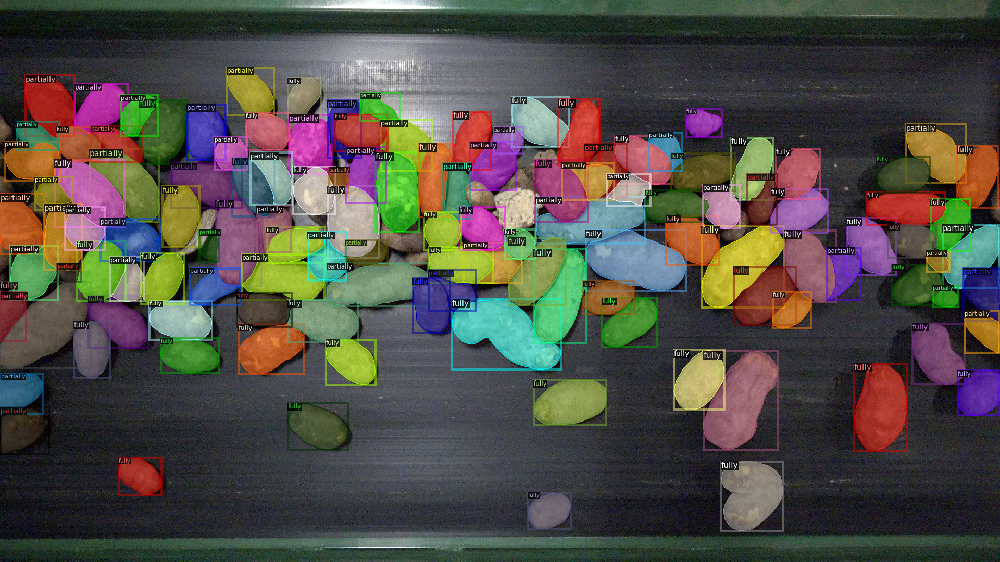

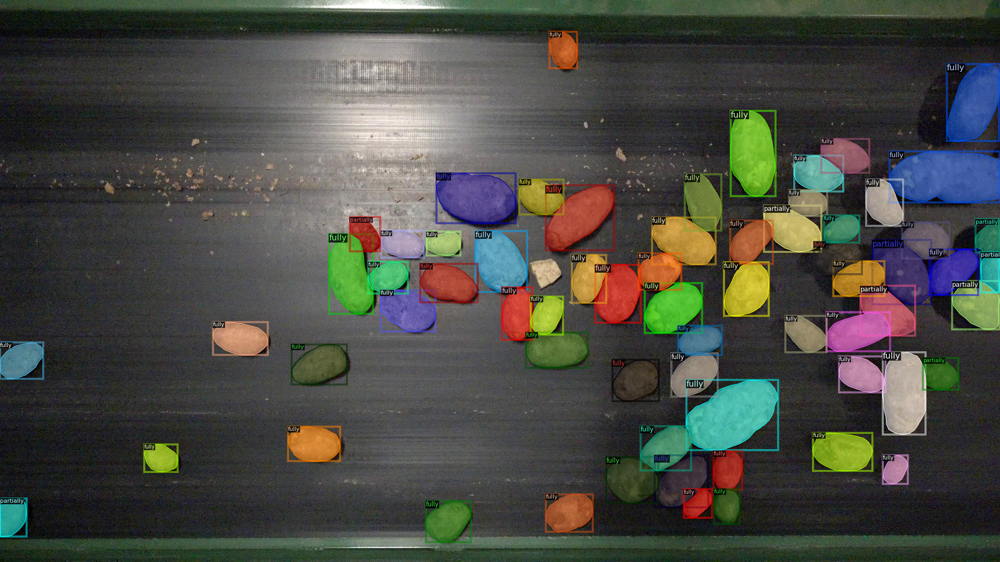

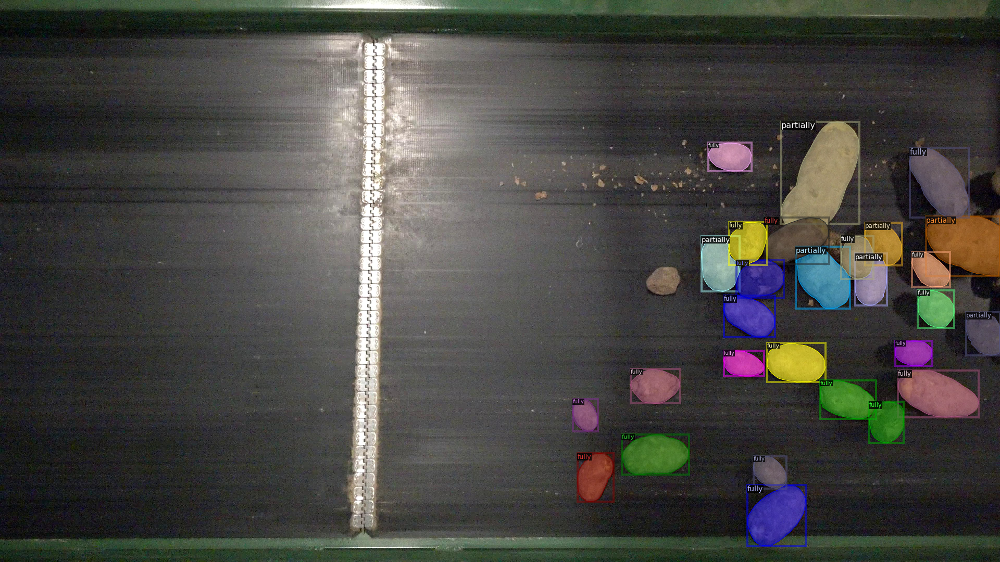

In [28]:
# if your dataset is in COCO format, this cell can be replaced by the following three lines:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("train", {}, train_annotation_path, train_img_path)
register_coco_instances("val", {}, val_annotation_path, val_img_path)

#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("train")
dataset_dicts = DatasetCatalog.get("train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [30]:
from detectron2.engine import DefaultTrainer
cfg = get_cfg()

cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml") # Let training initialize from model zoo

cfg.OUTPUT_DIR = "/content/drive/My Drive/TwoClass/output"
cfg.DATASETS.TRAIN = ("train",)
cfg.DATASETS.TEST = ("train",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2

cfg.SOLVER.MAX_ITER = 500

cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.5

cfg.SOLVER.BASE_LR = 0.001 #0.001
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128 #64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3

cfg.TEST.EVAL_PERIOD = 500

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[06/09 15:54:05 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (12, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (12,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (3, 256, 1, 1) 

[06/09 15:54:05 d2.engine.train_loop]: Starting training from iteration 0
[06/09 15:54:16 d2.utils.events]:  eta: 0:03:58  iter: 19  total_loss: 2.905  loss_cls: 1.305  loss_box_reg: 0.6088  loss_mask: 0.6827  loss_rpn_cls: 0.2628  loss_rpn_loc: 0.08238  time: 0.4977  data_time: 0.1848  lr: 3.8962e-05  max_mem: 3652M
[06/09 15:54:25 d2.utils.events]:  eta: 0:03:42  iter: 39  total_loss: 2.315  loss_cls: 0.9523  loss_box_reg: 0.6592  loss_mask: 0.5904  loss_rpn_cls: 0.02774  loss_rpn_loc: 0.07499  time: 0.4848  data_time: 0.1368  lr: 7.8922e-05  max_mem: 3652M
[06/09 15:54:34 d2.utils.events]:  eta: 0:03:28  iter: 59  total_loss: 1.881  loss_cls: 0.645  loss_box_reg: 0.6867  loss_mask: 0.4497  loss_rpn_cls: 0.01642  loss_rpn_loc: 0.06924  time: 0.4770  data_time: 0.1242  lr: 0.00011888  max_mem: 3652M
[06/09 15:54:44 d2.utils.events]:  eta: 0:03:19  iter: 79  total_loss: 1.609  loss_cls: 0.4947  loss_box_reg: 0.6907  loss_mask: 0.3366  loss_rpn_cls: 0.01527  loss_rpn_loc: 0.07144  time:

## Inference & evaluation using the trained model
Now, let's run inference with the trained model on the balloon validation dataset. First, let's create a predictor using the model we just trained:



In [36]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))
#cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_50_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 # Set threshold for this model
cfg.MODEL.WEIGHTS = "/content/drive/My Drive/TwoClass/output/model_final.pth" # Set path model .pth
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3
predictor = DefaultPredictor(cfg)

[06/09 16:04:09 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                          |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| backbone.bottom_up.res2.0.conv3.*               | backbone.bottom_up.res2.0.conv3.{norm.bia

Then, we randomly select several samples to visualize the prediction results.

In [37]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("d_train", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "d_train")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

WARNING [06/09 16:04:17 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/09 16:04:17 d2.data.datasets.coco]: Loaded 16 images in COCO format from /content/drive/My Drive/TwoClass/Train/train_coco.json
[06/09 16:04:17 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[06/09 16:04:17 d2.data.common]: Serializing 16 elements to byte tensors and concatenating them all ...
[06/09 16:04:17 d2.data.common]: Serialized dataset takes 0.26 MiB
[06/09 16:04:17 d2.evaluation.evaluator]: Start inference on 16 batches
[06/09 16:04:52 d2.evaluation.evaluator]: Inference done 11/16. Dataloading: 0.0026 s/iter. Inference: 0.1668 s/iter. Eval: 2.6880 s/iter. Total: 2.8574 s/iter. ETA=0:00:14
[06/09 16:04:58 d2.evaluation.evaluator]: Inference done 13/16. Dataloading: 0.0027 s/iter. Inference: 0.1694 s/iter. Eval: 2.7449 s/it

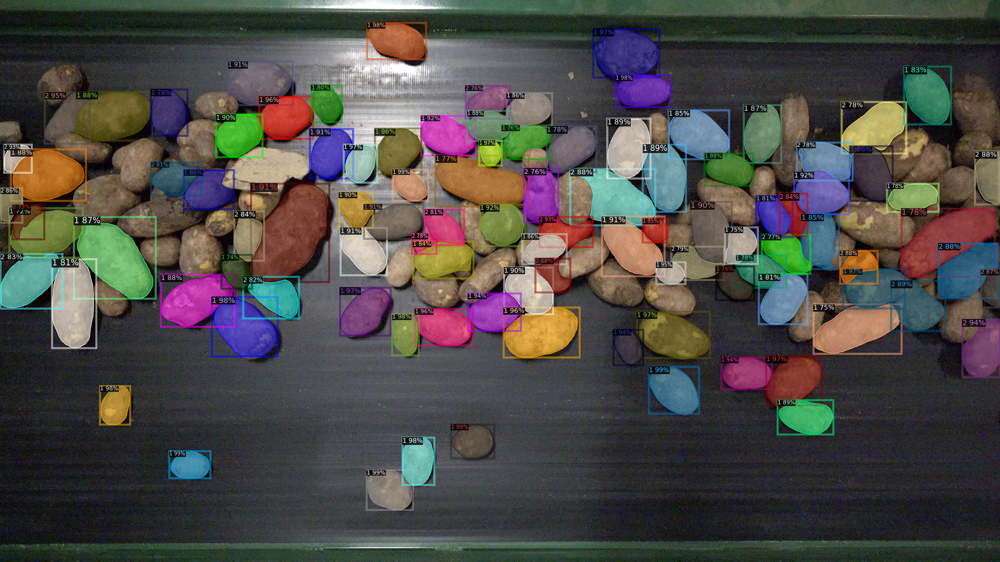

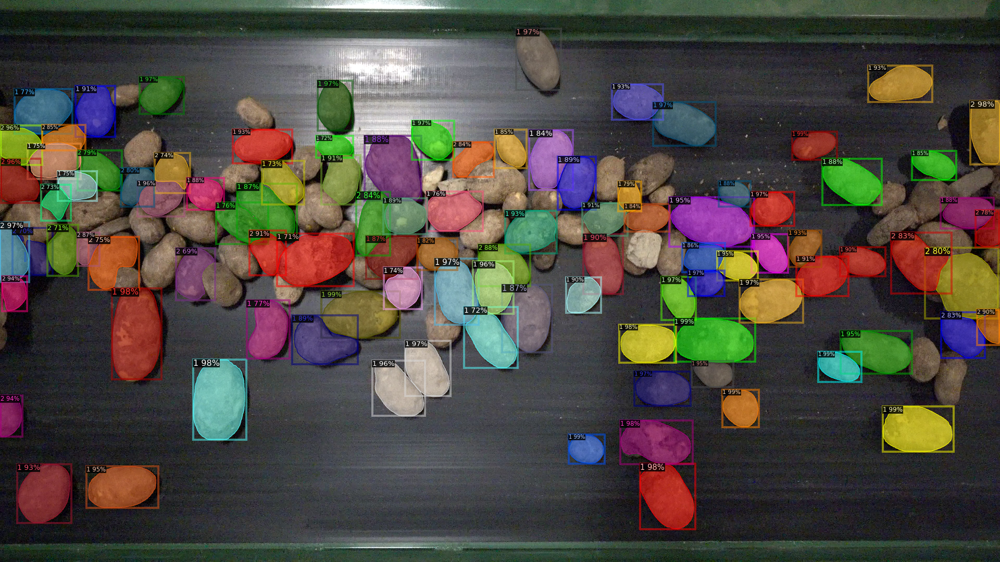

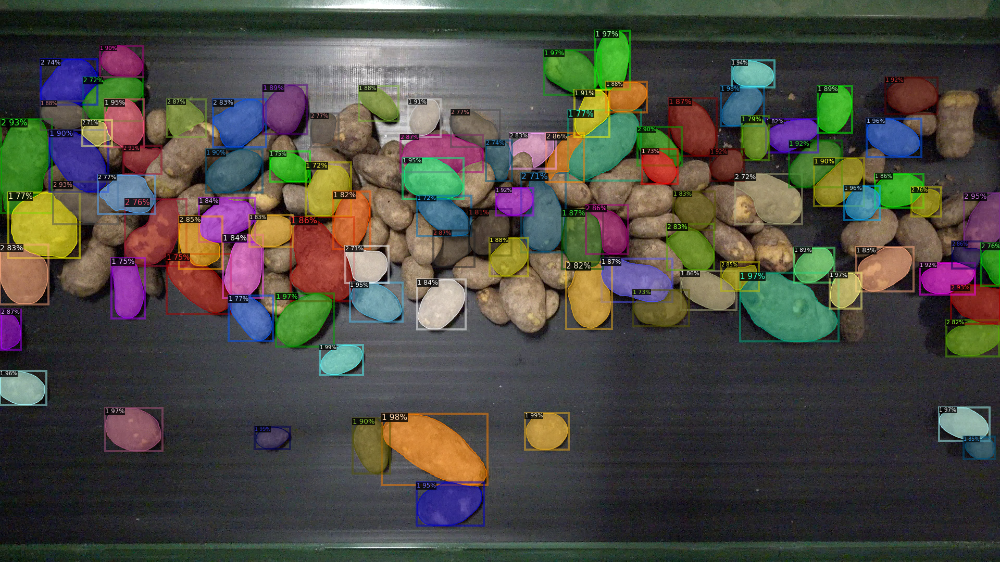

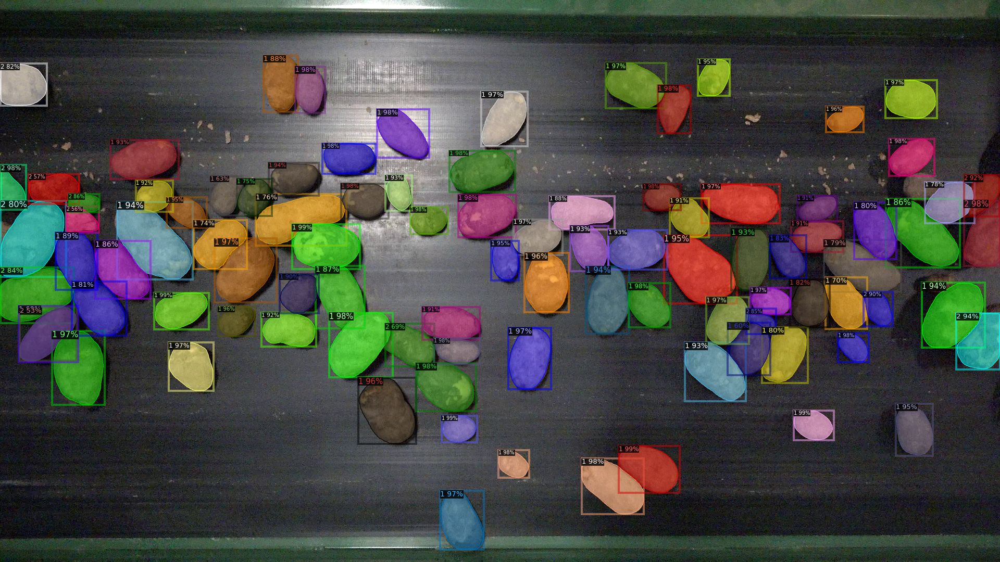

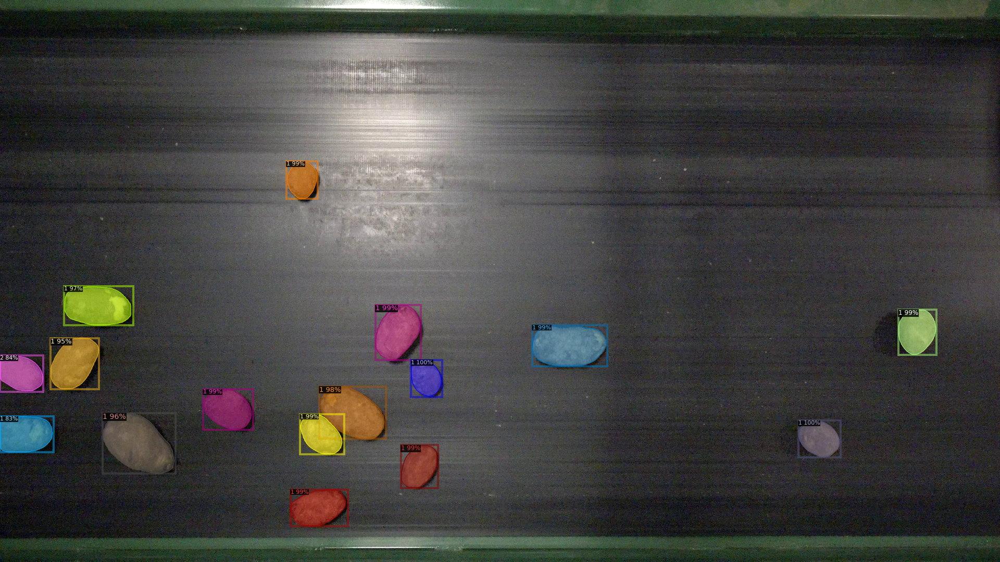

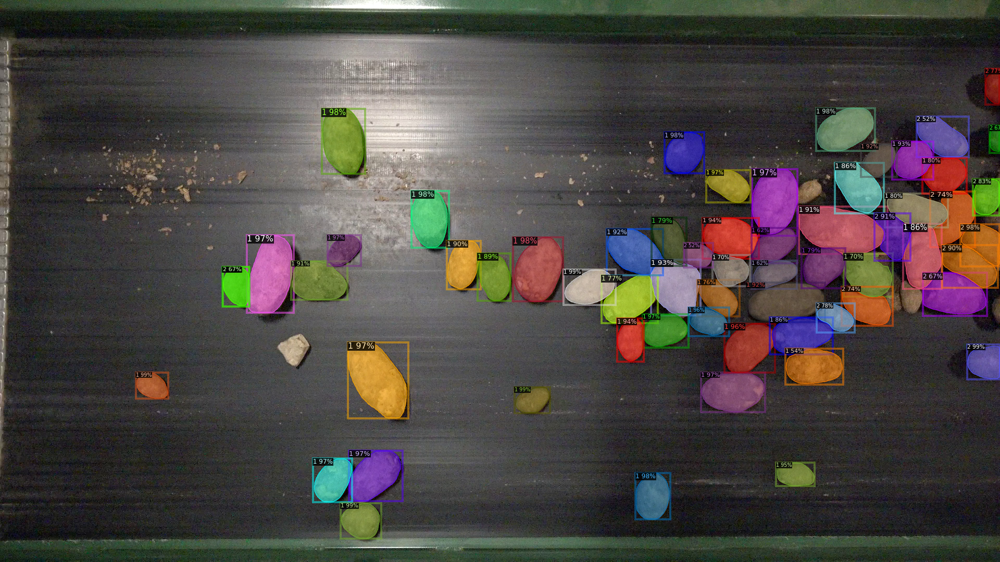

In [38]:
from detectron2.utils.visualizer import ColorMode
import glob
images = glob.glob(val_img_path+"/*")
for img in images:    
    im = cv2.imread(img)
    outputs = predictor(im)  
    v = Visualizer(im[:, :, ::-1], 
                  scale=0.5 
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])